In [1]:
%cd /home/sasedov/StyleDomain/SimilarDomains

/home/sasedov/StyleDomain/SimilarDomains


In [2]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
import PIL
import random

from torchvision import transforms
from torchvision.transforms import Resize, ToTensor
from omegaconf import OmegaConf
from core.utils.common import load_clip, mixing_noise
from core.utils.example_utils import (
    Inferencer, to_im, vstack_with_lines, hstack_with_lines, insert_image,
    project_e4e, project_restyle_psp, project_fse_without_image_generation, read_img
)
from core.utils.image_utils import construct_paper_image_grid
from core.utils.reading_weights import read_weights
from core.uda_models import OffsetsTunningGenerator

from pathlib import Path
from collections import defaultdict

from examples.draw_util import weights, set_seed, morph_g_ema, IdentityEditor, StyleEditor

from core.utils.example_utils import read_fse_config
scale, scale_mode, idx_k, n_styles, enc_residual, enc_residual_coeff, resnet_layers, stride = read_fse_config('FeatureStyleEncoder/configs/001.yaml')
print(scale, scale_mode, idx_k, n_styles, enc_residual, enc_residual_coeff, resnet_layers, stride)

/home/sasedov/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


2 bilinear 5 18 False False [4, 5, 6] (2, 2)


In [3]:
def stack_rows(rows, skip_horiz=10, skip_vertical=15):
    final_image = [
        hstack_with_lines(row_stack, skip_horiz) for row_stack in rows
    ]

    final_image = vstack_with_lines(final_image, skip_vertical)
    return PIL.Image.fromarray(final_image)


style_to_editor = {
    d: StyleEditor(read_weights(weights[d])) for d in weights if d not in ['horse', 'car', 'ffhq', 'cat', 'church', 'to_metfaces', 'to_afhqcat', 'to_afhqdog', 'to_mega']
}

style_to_editor['original'] = IdentityEditor()
device = 'cuda:0'

In [4]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
import numpy as np

class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec, title=''):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        self.title = title
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)
        # ax.set_title(self.title)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):
        self.sg.fig.set_size_inches(self.fig.get_size_inches())

In [5]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import pandas as pd
import seaborn as sns; sns.set()
import warnings

from matplotlib.text import Text


def plot_latent_correlations_by_layer(
        w1_numpy, w2_numpy, w3_numpy=None, w4_numpy=None,
        x_name='w_orig', y_name='w_enc', hue_name='enc_type',
        first_encoder_name='e4e', second_encoder_name='fse'
):
    """
    Default usage is:
    plot_latent_correlations_by_layer(
        w_e4e_numpy, w_fse_numpy, w_orig_numpy,
        x_name='w_orig', y_name='w_enc', hue_name='enc_type',
        first_encoder_name='e4e', second_encoder_name='fse'
    )
    
    Or:
    plot_latent_correlations_by_layer(
        w_fse_numpy, w_fse_offsets_numpy, w_orig_numpy, w_orig_offsets_numpy,
        x_name='w_orig', y_name='w_fse', hue_name='enc_type',
        first_encoder_name='fse', second_encoder_name='fse_with_offsets'
    )
    
    Or:
    plot_latent_correlations_by_layer(
        w_orig_numpy, w_e4e_numpy,
        x_name = 'w_orig', y_name = 'w_e4e'
    ) 
    """
    warnings.filterwarnings(
        action='ignore',
        category=FutureWarning
    )

    fig = plt.figure(figsize=(25, 20))

    n_rows, n_cols = 5, 4
    gs = gridspec.GridSpec(n_rows, n_cols)

    g = []
    mg = []
    
    for i in range(n_rows):
        for j in range(n_cols):
            latent_idx = i * n_cols + j
            if latent_idx < 18:
                if w3_numpy is None:
                    g.append(
                        sns.jointplot(
                            x = w1_numpy[0][latent_idx],
                            y = w2_numpy[0][latent_idx],
                            kind="kde",
                            space=0,
                            color="g"
                        )
                    )
                    g[-1].set_axis_labels(f'{x_name} {latent_idx}', f'{y_name} {latent_idx}', fontsize=10)
                else:
                    latent1, latent2, latent3 = w1_numpy[0][latent_idx], w2_numpy[0][latent_idx], w3_numpy[0][latent_idx]
                    latent4 = w4_numpy[0][latent_idx] if w4_numpy is not None else latent3
                    
                    data = {
                        x_name: np.concatenate((latent3, latent4), axis=0),
                        y_name: np.concatenate((latent1, latent2), axis=0),
                        hue_name: [first_encoder_name] * len(latent3) + [second_encoder_name] * len(latent4)
                    }
                    g.append(
                        sns.jointplot(
                            data = data,
                            x = x_name,
                            y = y_name,
                            kind = 'kde',
                            hue = hue_name,
                            space = 0
                        )
                    )
                    g[-1].set_axis_labels(f'{x_name} {latent_idx}', f'{y_name} {latent_idx}', fontsize=10)
                    
                    
                    # x_min, x_max = latent3.min(), latent3.max()
                    quantile = 0.5
                    x_min, x_max = np.percentile(latent3, quantile), np.percentile(latent3, 100 - quantile)
                    g[-1].ax_joint.plot([x_min, x_max], [x_min, x_max], 'green', linewidth=1.5)
                    
                    quantile = 0.5
                    x_min = min(np.percentile(latent1, quantile), np.percentile(latent2, quantile))
                    x_max = max(np.percentile(latent1, 100 - quantile), np.percentile(latent2, 100 - quantile))
                    g[-1].ax_marg_x.set_xlim(x_min, x_max)
                    g[-1].ax_marg_y.set_ylim(x_min, x_max)

                    
                    # КОСТЫЛЬ
#                     e4e_min, e4e_max = e4e_layer_coeffs[latent_idx] * x_min, e4e_layer_coeffs[latent_idx] * x_max
#                     fse_min, fse_max = fse_layer_coeffs[latent_idx] * x_min, fse_layer_coeffs[latent_idx] * x_max
                    
#                     g[-1].ax_joint.plot([x_min, x_max], [e4e_min, e4e_max], 'blue', linewidth = 2)
#                     g[-1].ax_joint.plot([x_min, x_max], [fse_min, fse_max], 'orange', linewidth = 2)
                    
                    sns.move_legend(g[-1].ax_joint, 'lower right')
                mg.append(SeabornFig2Grid(g[-1], fig, gs[latent_idx], title=f'layer_{latent_idx}'))                

    gs.tight_layout(fig)

In [6]:
ws_e4e = torch.load(f"ws_e4e_tensor.pt", map_location='cuda:0')
ws_fse = torch.load(f"ws_fse_tensor.pt", map_location='cuda:0')
# fse_features_tensor = torch.load("fse_features_tesnor.pt", map_location=device)
# orig_features_tensor_src = torch.load("orig_features_tensor_src.pt", map_location=device)
# orig_features_tensor_trg = torch.load("orig_features_tensor_trg.pt", map_location=device)

filenames = []
with open('latent_corr_exp_filenames.txt', 'r') as f:
    for line in f.readlines():
        filenames.append(line.strip())

In [7]:
filenames[974]

'01703.png'

In [8]:
gan_domain = 'ffhq'
s_domain = 'pop_art_indomain'
domain_desc = 'pop art'

ckpt = read_weights(weights[s_domain])
ckpt_ffhq = {'sg2_params': ckpt['sg2_params']}
ckpt_ffhq['sg2_params']['checkpoint_path'] = weights[gan_domain]

model = Inferencer(ckpt, device)

torch.Size([4096, 512])


In [9]:
from contextlib import redirect_stdout
import io

def get_conv_styles(model, inputs, input_is_latent=False, verbose=False):
    if not verbose:
        f_stdout = io.StringIO()
    
    with redirect_stdout(f_stdout):
        styles = []
        for input in inputs:
            if input.ndim < 3:
                input = input.unsqueeze(0)
            styles.append(model.sg2_source.get_s_code(input, input_is_latent=input_is_latent))

        conv_styles = []
        for sample_styles in styles:
            sample_conv_styles = [sample_styles[0], sample_styles[1]]

            # kick styles for RGB layers
            for style_idx in range(2, len(sample_styles)):
                if (style_idx - 2) % 3 != 2:
                    sample_conv_styles.append(sample_styles[style_idx])

            conv_styles.append(sample_conv_styles)
    
    return conv_styles

def get_mean_styles(styles):
    return [
        sum(x[style_idx] for x in styles) / len(styles)
        for style_idx in range(len(styles[0]))
    ]

In [10]:
n_samples = 1000

style_dim = model.sg2_source.generator.style_dim
zs = torch.from_numpy(np.random.normal(size=(n_samples, style_dim)).astype(np.float32)).unsqueeze(1).to(device)

stoch_styles = get_conv_styles(model, zs, input_is_latent=False)
mean_stoch_styles = get_mean_styles(stoch_styles)

e4e_styles = get_conv_styles(model, ws_e4e, input_is_latent=True)
mean_e4e_styles = get_mean_styles(e4e_styles)
e4e_im_styles = get_conv_styles(model, ws_e4e[0].unsqueeze(0), input_is_latent=True)[0]

fse_styles = get_conv_styles(model, ws_fse, input_is_latent=True)
mean_fse_styles = get_mean_styles(fse_styles)
fse_im_styles = get_conv_styles(model, ws_fse[0].unsqueeze(0), input_is_latent=True)[0]

mean_stoch_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in mean_stoch_styles]]
mean_e4e_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in mean_e4e_styles]]
e4e_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in e4e_im_styles]]
mean_fse_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in mean_fse_styles]]
fse_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in fse_im_styles]]


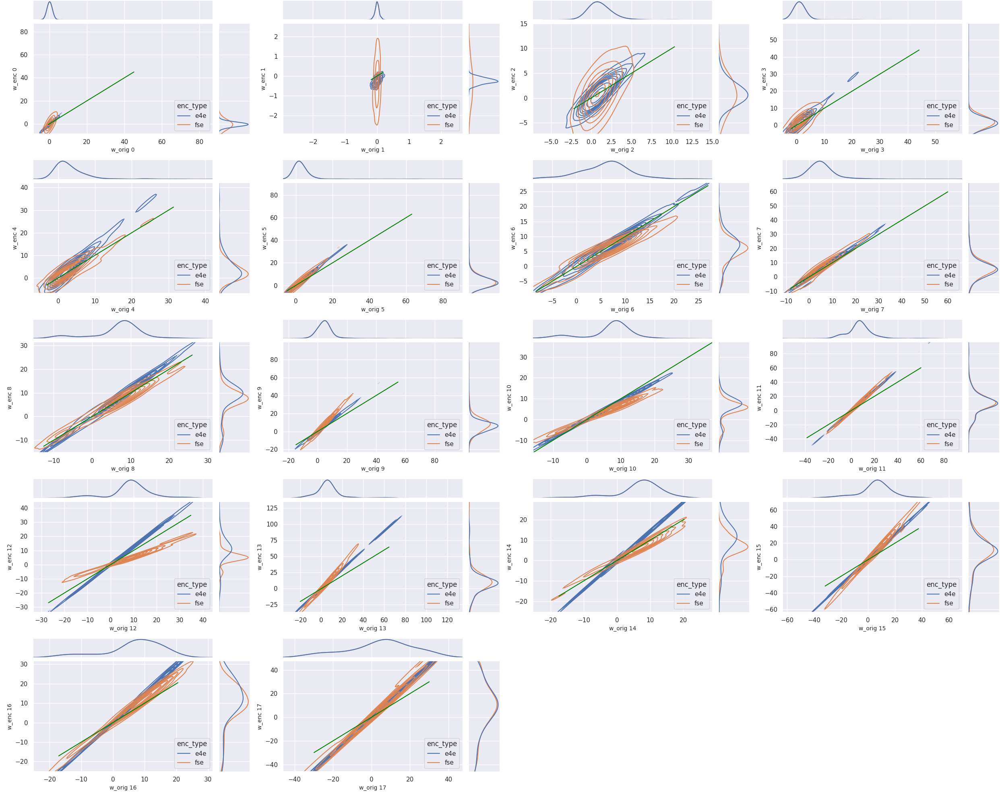

In [34]:
# MEAN DISTRIBUTION

plot_latent_correlations_by_layer(
    mean_e4e_styles_numpy,
    mean_fse_styles_numpy,
    mean_stoch_styles_numpy
)

In [36]:
# e4e_layer_coeffs = []
# fse_layer_coeffs = []

# for style_idx in range(18):
#     style_e4e = mean_e4e_styles_numpy[0][style_idx]
#     style_fse = mean_fse_styles_numpy[0][style_idx]
#     style_stoch = mean_stoch_styles_numpy[0][style_idx]
    
#     e4e_coeff, fse_coeff = 0., 0.
#     for y1, y2, x in zip(style_e4e, style_fse, style_stoch):
#         e4e_coeff += y1 / x 
#         fse_coeff += y2 / x
    
#     e4e_coeff /= len(style_stoch)
#     fse_coeff /= len(style_stoch)
    
#     print(f'Layer {style_idx}, e4e coeff: {e4e_coeff}, fse coeff: {fse_coeff}')
    
#     e4e_layer_coeffs.append(e4e_coeff)
#     fse_layer_coeffs.append(fse_coeff)

Layer 0, e4e coeff: 1.0515549093047412, fse coeff: 7.71008872270977
Layer 1, e4e coeff: -3.104521551867947, fse coeff: -10.34948935200373
Layer 2, e4e coeff: 0.7572166312065747, fse coeff: 2.478549008772461
Layer 3, e4e coeff: -3.963301036863413, fse coeff: 5.286714213474625
Layer 4, e4e coeff: 0.6183898082490487, fse coeff: 1.6894849331538353
Layer 5, e4e coeff: -13.997302193409269, fse coeff: 14.7880237239292
Layer 6, e4e coeff: 0.9586052098384243, fse coeff: 0.9987896857965097
Layer 7, e4e coeff: 1.2266582229058258, fse coeff: 1.2470829930098262
Layer 8, e4e coeff: 1.1906525293234154, fse coeff: 0.9784246133567649
Layer 9, e4e coeff: 1.3065573656422202, fse coeff: 1.6536865971611405
Layer 10, e4e coeff: 0.8820493581006303, fse coeff: 0.6777648330225929
Layer 11, e4e coeff: 1.4190322073409334, fse coeff: 1.5168224941007793
Layer 12, e4e coeff: 1.3739632440265268, fse coeff: 0.5497937330510467
Layer 13, e4e coeff: 1.2787407962605357, fse coeff: 1.6080783065408468
Layer 14, e4e coeff: 

In [11]:
from sklearn.linear_model import LinearRegression

e4e_layer_coeffs = []
fse_layer_coeffs = []

for style_idx in range(18):
    style_e4e = mean_e4e_styles_numpy[0][style_idx]
    style_fse = mean_fse_styles_numpy[0][style_idx]
    style_stoch = mean_stoch_styles_numpy[0][style_idx]
    
    e4e_regr = LinearRegression()
    e4e_regr.fit(style_e4e[:, None], style_stoch)
        
    fse_regr = LinearRegression()
    fse_regr.fit(style_fse[:, None], style_stoch)
    
    print(f'Layer {style_idx}, e4e coeff: {e4e_regr.coef_[0]}, fse coeff: {fse_regr.coef_[0]}')
    
    e4e_layer_coeffs.append(e4e_regr.coef_[0])
    fse_layer_coeffs.append(fse_regr.coef_[0])

Layer 0, e4e coeff: 0.7208563089370728, fse coeff: 0.4641726016998291
Layer 1, e4e coeff: 0.25438857078552246, fse coeff: 0.008958063088357449
Layer 2, e4e coeff: 0.6498948335647583, fse coeff: 0.4682895541191101
Layer 3, e4e coeff: 0.7266859412193298, fse coeff: 0.7070271372795105
Layer 4, e4e coeff: 0.676094651222229, fse coeff: 0.9155831933021545
Layer 5, e4e coeff: 0.7726922631263733, fse coeff: 0.6826440095901489
Layer 6, e4e coeff: 0.9463874697685242, fse coeff: 1.1461633443832397
Layer 7, e4e coeff: 0.8992733955383301, fse coeff: 0.8863893151283264
Layer 8, e4e coeff: 0.844778299331665, fse coeff: 1.0410250425338745
Layer 9, e4e coeff: 0.7735204696655273, fse coeff: 0.5682533383369446
Layer 10, e4e coeff: 1.1224958896636963, fse coeff: 1.4354928731918335
Layer 11, e4e coeff: 0.7026931643486023, fse coeff: 0.6415066123008728
Layer 12, e4e coeff: 0.788485050201416, fse coeff: 1.7144241333007812
Layer 13, e4e coeff: 0.667069137096405, fse coeff: 0.5040286779403687
Layer 14, e4e coe

In [73]:
e4e_offsets_coeffs = [1 / x for x in e4e_layer_coeffs]
fse_offsets_coeffs = [1 / x for x in fse_layer_coeffs]

In [89]:
image_path = 'examples/photos/01703.png'
im = read_img(image_path, align_input=True)

w_single = project_e4e(im, 'pretrained/e4e_ffhq_encode.pt')[1]
empty_img, w_fse, fse_features = project_fse_without_image_generation(
    im,
    model_path='pretrained/143_enc.pth',
    fse_config_name='001',
    arcface_model_path='pretrained/backbone.pth',
    stylegan_model_path='pretrained/StyleGAN2/stylegan2-ffhq-config-f.pt'
)

gan_domain = 'ffhq'
s_domain = 'murasaki_nora_asuya'
# s_domain = 'oliver_wetter_corie_lynn_concept_1_final_back_web'
# s_domain = 'remi_castaneda_sean_connery_final'

ckpt = read_weights(weights[s_domain])
ckpt_ffhq = {'sg2_params': ckpt['sg2_params']}
ckpt_ffhq['sg2_params']['checkpoint_path'] = weights[gan_domain]

model = Inferencer(ckpt, device)

Aligned image has shape: (1024, 1024)
Loading e4e over the pSp framework from checkpoint: pretrained/e4e_ffhq_encode.pt
torch.Size([3, 256, 256])
torch.Size([1, 3, 256, 256])
torch.Size([3, 1024, 1024])
torch.Size([1, 3, 1024, 1024])
torch.Size([1, 3, 256, 256])
torch.Size([4096, 512])


In [90]:
offsets = model.model_da()

In [91]:
offsets['conv_0'].keys()

dict_keys(['in'])

In [92]:
shifted_offsets = {}
for coeff, conv_name in zip(e4e_layer_coeffs[1:], offsets.keys()):
    shifted_offsets[conv_name] = {}
    shifted_offsets[conv_name]['in'] = (1 / coeff) * offsets[conv_name]['in']

In [93]:
for conv_name in offsets.keys():
    print(conv_name, torch.norm(offsets[conv_name]['in']).item(), torch.norm(offsets[conv_name]['in'] - shifted_offsets[conv_name]['in']).item())

conv_0 10.242558479309082 30.0208797454834
conv_1 11.558835983276367 6.226866245269775
conv_2 11.075666427612305 4.165672302246094
conv_3 11.563036918640137 5.539652347564697
conv_4 12.849458694458008 3.7800066471099854
conv_5 14.171045303344727 0.8027851581573486
conv_6 15.706653594970703 1.7592854499816895
conv_7 19.22323226928711 3.5321249961853027
conv_8 21.737960815429688 6.36467170715332
conv_9 24.868131637573242 2.7138123512268066
conv_10 20.185260772705078 8.540308952331543
conv_11 22.115087509155273 5.9324798583984375
conv_12 16.360145568847656 8.165266990661621
conv_13 16.426013946533203 7.252375602722168
conv_14 10.372197151184082 5.41370964050293
conv_15 11.362615585327148 5.535675525665283
conv_16 11.02962875366211 5.3880391120910645


In [94]:
from visualize import stack_to_grid_with_names, text_on_square_image
from core.utils.example_utils import to_im
from PIL import ImageFont

latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
latent.shape: torch.Size([1, 18, 512])
5 torch.Size([1, 512, 16, 16]) torch.Size([1, 512, 16, 16])
latent.shape: torch.Size([1, 18, 512])
5 torch.Size([1, 512, 16, 16]) torch.Size([1, 512, 16, 16])
latent.shape: torch.Size([1, 18, 512])
5 torch.Size([1, 512, 16, 16]) torch.Size([1, 512, 16, 16])
latent.shape: torch.Size([1, 18, 512])
5 torch.Size([1, 512, 16, 16]) torch.Size([1, 512, 16, 16])


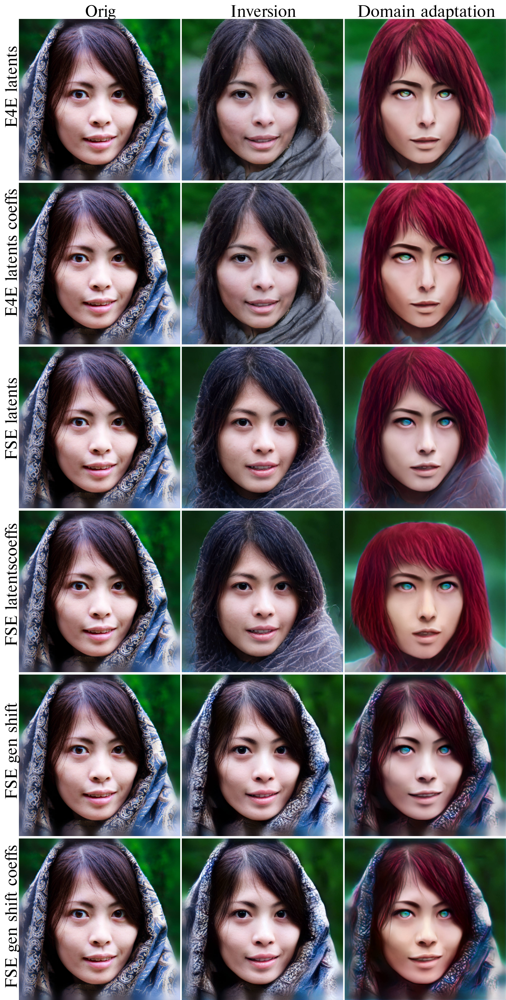

In [95]:
prepare = lambda x: np.array(to_im(resize(x), padding=0))
transform = transforms.Compose(
    [
        transforms.Resize((1024, 1024)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ]
)

image_size = 1024

resize = transforms.Resize((image_size, image_size))

row_stack = []
for w, f, offsets_coeffs, shift_flag in zip(
    [w_single, w_single, w_fse, w_fse, w_fse, w_fse],
    [None, None, None, None, fse_features, fse_features],
    [None, e4e_offsets_coeffs, None, fse_offsets_coeffs, None, fse_offsets_coeffs],
    [None, None, None, None, False, False]
):
    src, trg = model(
        [w], features_in=f,
        input_is_latent=True, is_s_code=False,
        shift_with_generator_feature_map=shift_flag,
        offsets_coeffs=offsets_coeffs
    )

    im_ = transform(im).unsqueeze(0).cpu()
    src = src.detach().cpu()
    trg = trg.detach().cpu()
    
    row_stack.append([prepare(im_), prepare(src), prepare(trg)])

styled_image = stack_to_grid_with_names(
    imgs_list=row_stack, H=image_size, W=image_size,
    row_names=["E4E latents", "E4E latents coeffs", "FSE latents", "FSE latentscoeffs", "FSE gen shift", "FSE gen shift coeffs"],
    column_names=["Orig", f"Inversion", f"Domain adaptation"],
    font=ImageFont.truetype("/home/sasedov/Times.ttf", 25 * image_size // 256),
    text_field_height=25
)
styled_image

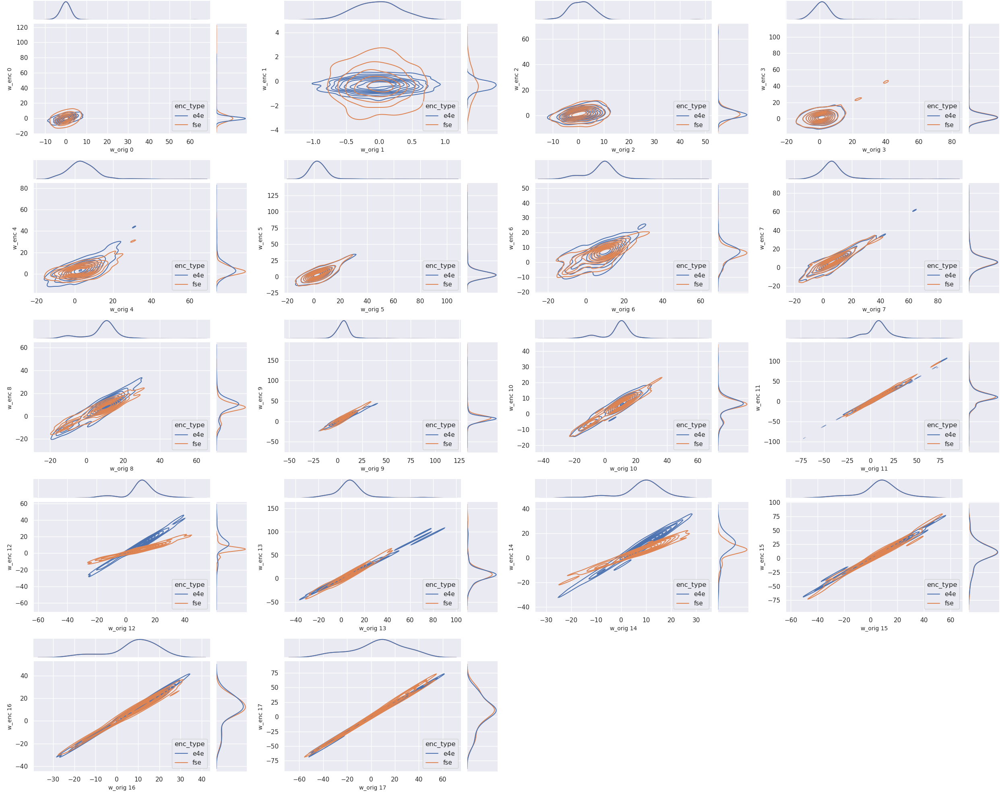

In [14]:
# PER-IMAGE DISTRIBUTION

stoch_im_styles = stoch_styles[0]

stoch_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in stoch_im_styles]]
e4e_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in e4e_im_styles]]
fse_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in fse_im_styles]]

plot_latent_correlations_by_layer(
    e4e_im_styles_numpy,
    fse_im_styles_numpy, 
    stoch_im_styles_numpy
)

In [ ]:
# INCORPORATING DOMAIN OFFSETS

In [40]:
from collections import defaultdict
from contextlib import redirect_stdout
from pathlib import Path
from tqdm import tqdm

import io
import os
import yaml

def get_image_domains():
    f_stdout = io.StringIO()

    domain_images_path = 'image_domains/'
    domain_images = {}

    for domain_image_filename in tqdm(os.listdir(domain_images_path)):
        s_domain, file_ext = domain_image_filename.split('.')
        if file_ext in ['png', 'jpg'] and s_domain != 'anime' and s_domain in weights:
            with redirect_stdout(f_stdout):
                domain_images[s_domain] = read_img(domain_images_path + domain_image_filename, align_input=True)

    domain_images = domain_images.items()
    s_domains = [x[0] for x in domain_images]
    domain_ims = [x[1] for x in domain_images]

    print('Considering the following domains:', *s_domains)
    return s_domains, domain_ims

def get_text_domains(domain_dir_path='pretrained/checkpoints_iccv'):
    path = Path(domain_dir_path)
    
    s_domains = []
    domain_texts = []
    
    for domain_dir in tqdm(path.iterdir()):
        with open(domain_dir / 'config.yaml', 'r') as file:
            domain_config = yaml.safe_load(file)
        
        if domain_config['training']['target_class'][-4:] not in ['.png', '.jpg']:
            s_domains.append(domain_dir.name[:-7])  # cut out _sdelta in the end
            domain_texts.append(domain_config['training']['target_class'])
            if 'indomain' in s_domains[-1]:
                domain_texts[-1] += ' (indomain)'
    
    return s_domains, domain_texts

In [53]:
# MEASURE LAYER OFFSETS FOR EACH DOMAIN

def measure_offset_norms_by_layer(s_domains):
    gan_domain = 'ffhq'
    # s_domains.append('pop_art_indomain')

    layer_offsets_by_domain = {}
    mean_layer_norms = defaultdict(float)

    for s_domain in s_domains:
        print(f'\nDOMAIN {s_domain}:')
        ckpt = read_weights(weights[s_domain])
        ckpt_ffhq = {'sg2_params': ckpt['sg2_params']}
        ckpt_ffhq['sg2_params']['checkpoint_path'] = weights[gan_domain]

        model = Inferencer(ckpt, device)

        layer_offsets_by_domain[s_domain] = {}
        for layer_name, layer_value in model.model_da().items():
            layer_norm = layer_value['in'].norm().detach().cpu().numpy()
            print(f'{layer_name}: {layer_norm}, layer_value.shape: {layer_value["in"].shape}')

            mean_layer_norms[layer_name] += layer_norm
            layer_offsets_by_domain[s_domain][layer_name] = layer_value['in'].detach()

    print(f'\nMean layer norms across selected s_domains:')
    for layer_name, layer_norm in mean_layer_norms.items():
        mean_layer_norms[layer_name] = layer_norm / len(s_domains)
        print(f'{layer_name}: {mean_layer_norms[layer_name]}')
    
    return mean_layer_norms, layer_offsets_by_domain

In [42]:
im_domains, domain_ims = get_image_domains()

ignored_image_domains = ['joker', 'sketch']
for domain in ignored_image_domains:
    ind = im_domains.index(domain)
    im_domains.pop(ind)
    domain_ims.pop(ind)

text_domains, domain_texts = get_text_domains()

s_domains = im_domains + text_domains
domain_ims_or_texts = domain_ims + domain_texts

100%|██████████| 36/36 [01:31<00:00,  2.54s/it]


Considering the following domains: jojo nigelwy_untitled_artwork_18 digital_painting_jing titan_armin joker oliver_wetter_corie_lynn_concept_1_final_back_web murasaki_nora_asuya disney_princess remi_castaneda_sean_connery_final stanislav_galai_04_23 anastasia sketch maria_trepalina_img_6833_1 rain_artwork_dtiyschallennge mermaid truc_huynh_hex_009v2 speed_paint naufal_ilyasa_seraphine_ig_full_res rich_d_amaru_studyfinal ricardo_viana_render2 wesley_gardner_portraitstudy titan_erwin


76it [00:01, 53.38it/s]


In [44]:
domain_types = {}

for domain_type in ['all', 'image', 'text']:
    domain_types[domain_type] = {}
    for domain_quality_type in ['diff', 'mid', 'sim']:
        type_filestr = '' if domain_type == 'all' else domain_type + '_'
        
        with open(f'domain_encoder_metrics/{type_filestr}{domain_quality_type}_domains_list.txt', 'r') as f:
            domain_types[domain_type][domain_quality_type] = set()
            
            for line in f.readlines():
                s_domain = line.strip().split(' ')[0]
                
                if domain_type == 'image' and s_domain in ignored_image_domains:
                    continue
                
                domain_types[domain_type][domain_quality_type].add(s_domain)

In [45]:
domain_indices_by_type = {}
s_domains_by_type = {}
domain_ims_or_texts_by_type = {}

for domain_type, domain_groups in domain_types.items():
    domain_indices_by_type[domain_type] = {}
    s_domains_by_type[domain_type] = {}
    domain_ims_or_texts_by_type[domain_type] = {}
    
    for key, domains in domain_groups.items():
        domain_indices_by_type[domain_type][key] = [i for i, d in enumerate(s_domains) if d in domains]
        s_domains_by_type[domain_type][key] = [s_domains[i] for i in domain_indices_by_type[domain_type][key]]
        domain_ims_or_texts_by_type[domain_type][key] = [domain_ims_or_texts[i] for i in domain_indices_by_type[domain_type][key]]

In [55]:
f_stdout = io.StringIO()

with redirect_stdout(f_stdout):
    text_mean_layer_norms, text_layer_offsets_by_domain = measure_offset_norms_by_layer(text_domains)
    text_diff_mean_layer_norms, text_diff_layer_offsets_by_domain = measure_offset_norms_by_layer(s_domains_by_type['text']['diff'])
    text_mid_mean_layer_norms, text_mid_layer_offsets_by_domain = measure_offset_norms_by_layer(s_domains_by_type['text']['mid'])
    text_sim_mean_layer_norms, text_sim_layer_offsets_by_domain = measure_offset_norms_by_layer(s_domains_by_type['text']['sim'])
    
    image_mean_layer_norms, image_layer_offsets_by_domain = measure_offset_norms_by_layer(im_domains)
    image_diff_mean_layer_norms, image_diff_layer_offsets_by_domain = measure_offset_norms_by_layer(s_domains_by_type['image']['diff'])
    image_mid_mean_layer_norms, image_mid_layer_offsets_by_domain = measure_offset_norms_by_layer(s_domains_by_type['image']['mid'])
    image_sim_mean_layer_norms, image_sim_layer_offsets_by_domain = measure_offset_norms_by_layer(s_domains_by_type['image']['sim'])

print(f'Text domains layer norms:\n{text_mean_layer_norms}\n')
print(f'Diff text domains layer norms:\n{text_diff_mean_layer_norms}\n')
print(f'Mid text domains layer norms:\n{text_mid_mean_layer_norms}\n')
print(f'Sim text domains layer norms:\n{text_sim_mean_layer_norms}\n')
    
print(f'Image domains layer norms:\n{image_mean_layer_norms}\n')
print(f'Diff image domains layer norms:\n{image_diff_mean_layer_norms}\n')
print(f'Mid image domains layer norms:\n{image_mid_mean_layer_norms}\n')
print(f'Sim image domains layer norms:\n{image_sim_mean_layer_norms}\n')

Text domains layer norms:
defaultdict(<class 'float'>, {'conv_0': 6.028531761169433, 'conv_1': 6.345787143707275, 'conv_2': 7.04263391494751, 'conv_3': 7.8259703636169435, 'conv_4': 8.944972801208497, 'conv_5': 9.492278633117676, 'conv_6': 27.969639472961425, 'conv_7': 28.35025375366211, 'conv_8': 31.791847534179688, 'conv_9': 32.823078308105465, 'conv_10': 24.773292350769044, 'conv_11': 26.188654441833496, 'conv_12': 17.950974559783937, 'conv_13': 18.26057704925537, 'conv_14': 12.492906646728516, 'conv_15': 13.33714427947998, 'conv_16': 9.991522521972657})

Diff text domains layer norms:
defaultdict(<class 'float'>, {'conv_0': 12.278781509399414, 'conv_1': 12.389100170135498, 'conv_2': 13.977343368530274, 'conv_3': 15.517563819885254, 'conv_4': 17.675540161132812, 'conv_5': 18.61470718383789, 'conv_6': 30.30728416442871, 'conv_7': 30.747869873046874, 'conv_8': 34.270515251159665, 'conv_9': 34.94388656616211, 'conv_10': 26.097135925292967, 'conv_11': 26.828273391723634, 'conv_12': 17.8

In [58]:
import pandas as pd

stats = {
    'text all': [text_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'text diff': [text_diff_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'text mid': [text_mid_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'text sim': [text_sim_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'image all': [image_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'image diff': [image_diff_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'image mid': [image_mid_mean_layer_norms[f'conv_{i}'] for i in range(17)],
    'image sim': [image_sim_mean_layer_norms[f'conv_{i}'] for i in range(17)]
}

pd.DataFrame(stats)

,text all,text diff,text mid,text sim,image all,image diff,image mid,image sim
0,6.028532,12.278782,7.978893,1.722411,9.225422,8.986106,10.601728,8.442552
1,6.345787,12.389100,8.355595,2.100323,11.037203,11.125485,12.030014,10.054964
2,7.042634,13.977343,9.189634,2.291932,11.189784,11.127028,12.500408,10.237923
3,7.825970,15.517564,10.285843,2.536702,12.543606,12.791762,13.884082,11.218082
4,8.944973,17.675540,11.894566,2.804499,13.873184,14.207923,15.626798,11.747916
5,9.492279,18.614707,12.514961,3.107304,15.664413,15.921146,17.162052,14.208404
6,27.969639,30.307284,29.135846,25.889947,17.985650,18.486540,19.597431,15.984652
7,28.350254,30.747870,30.038154,25.843616,20.480595,20.929270,22.103179,18.588291
8,31.791848,34.270515,33.248665,29.424883,22.352939,22.218544,24.505900,20.849136
9,32.823078,34.943887,34.647296,30.389819,24.831369,24.352773,27.506390,23.103993


In [63]:
# PER-IMAGE DISTRIBUTION WITH DOMAIN OFFSETS

stoch_im_styles = stoch_styles[0]
s_domain = 'tolkien_elf'
s_domain2 = 'sketch'

stoch_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in stoch_im_styles]]
e4e_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in e4e_im_styles]]
fse_im_styles_numpy = [[x.squeeze(0).cpu().numpy() for x in fse_im_styles]]

# OFFSETS HAVE 17 LAYERS, WHILE ORIGINAL STYLEGAN-STYLES HAVE 18 - WE ADD ZEROS FOR THE FIRST LAYER
layer_offsets_numpy = [[np.zeros(512)] + [x.squeeze(0).cpu().numpy() for x in layer_offsets_by_domain[s_domain].values()]]
layer_offsets_numpy2 = [[np.zeros(512)] + [x.squeeze(0).cpu().numpy() for x in layer_offsets_by_domain[s_domain2].values()]]

for x, y in zip(stoch_im_styles_numpy[0], layer_offsets_numpy[0]):
    assert x.shape == y.shape, f'{x.shape}, {y.shape}'

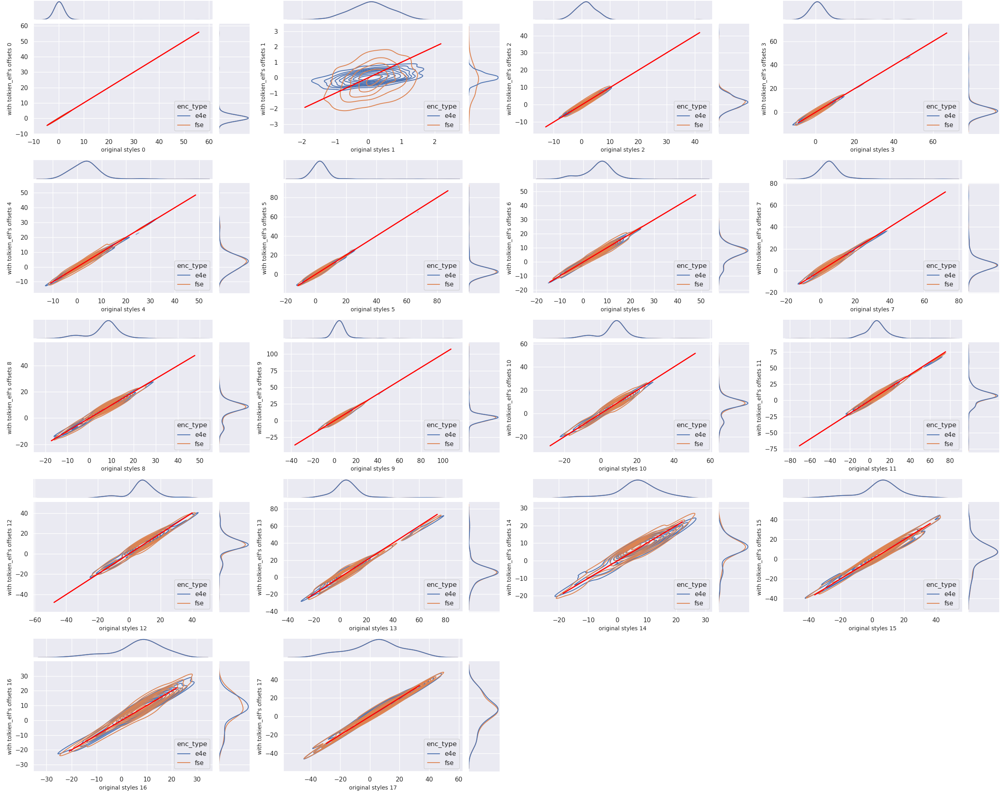

In [66]:
# s_domain = 'tolkien_elf'
# s_domain2 = 'sketch'

plot_latent_correlations_by_layer(
    stoch_im_styles_numpy,
    [[style + offset for style, offset in zip(stoch_im_styles_numpy[0], layer_offsets_numpy[0])]],
    [[style + offset for style, offset in zip(stoch_im_styles_numpy[0], layer_offsets_numpy2[0])]],
    x_name="original styles",
    y_name=f"with {s_domain}'s offsets"
)

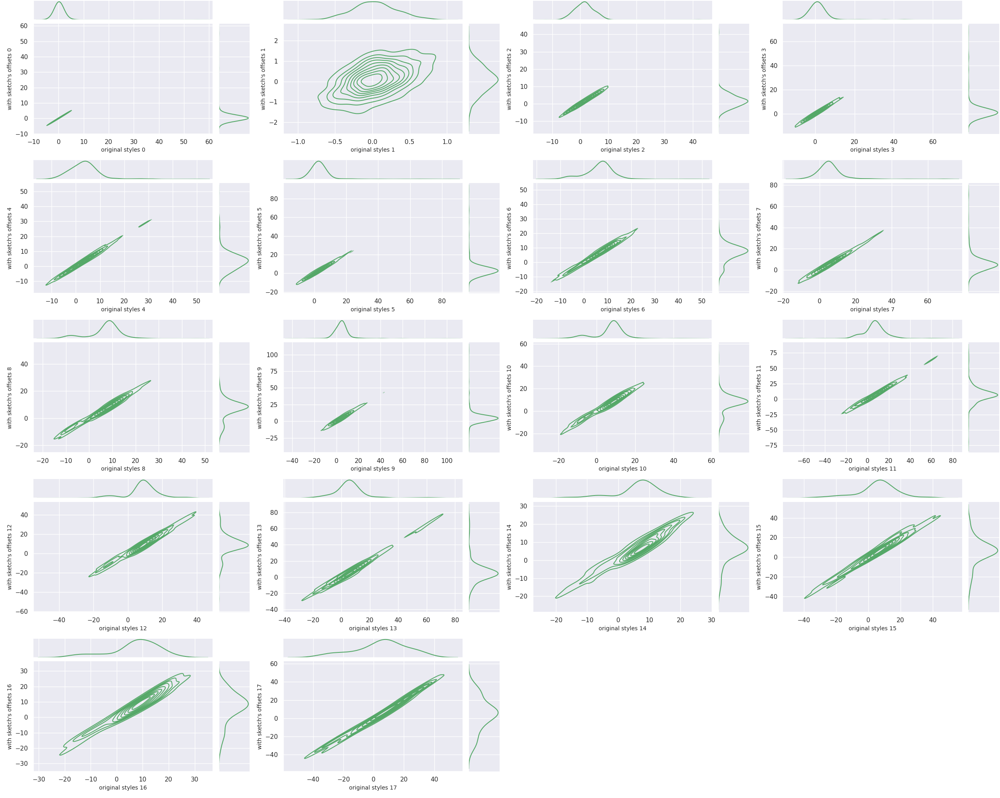

In [62]:
# s_domain = 'sketch'

plot_latent_correlations_by_layer(
    stoch_im_styles_numpy,
    [[style + offset for style, offset in zip(stoch_im_styles_numpy[0], layer_offsets_numpy[0])]],
    x_name="original styles",
    y_name=f"with {s_domain}'s offsets"
)

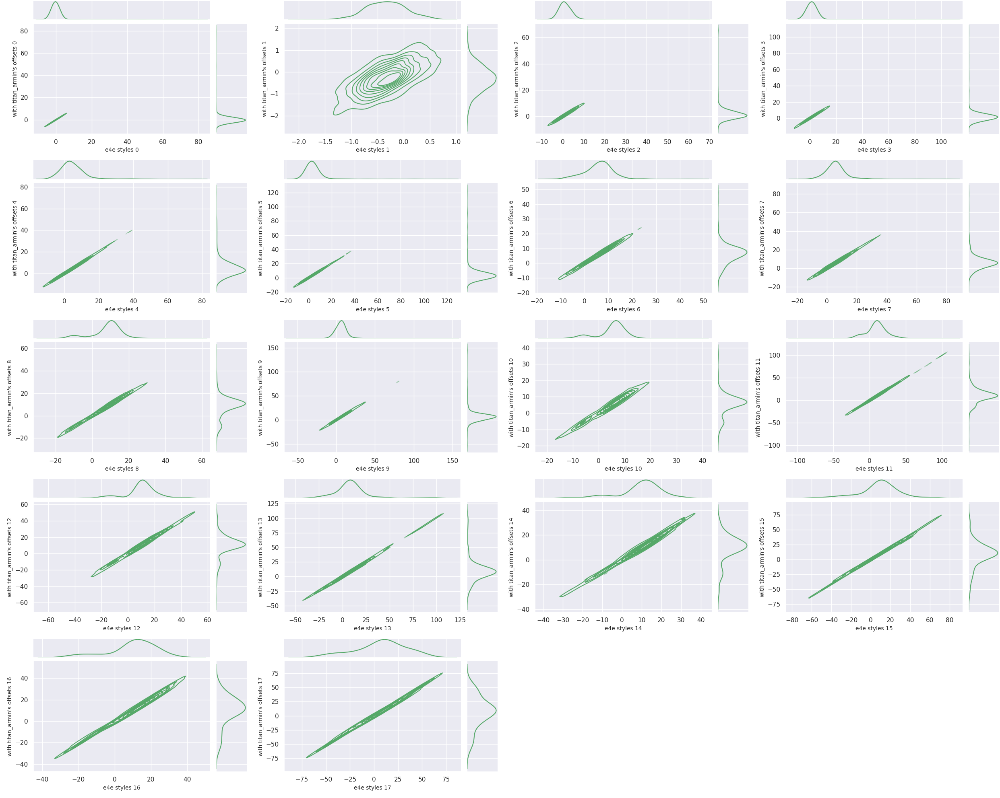

In [19]:
plot_latent_correlations_by_layer(
    e4e_im_styles_numpy,
    [[style + offset for style, offset in zip(e4e_im_styles_numpy[0], layer_offsets_numpy[0])]],
    x_name="e4e styles",
    y_name=f"with {s_domain}'s offsets"
)

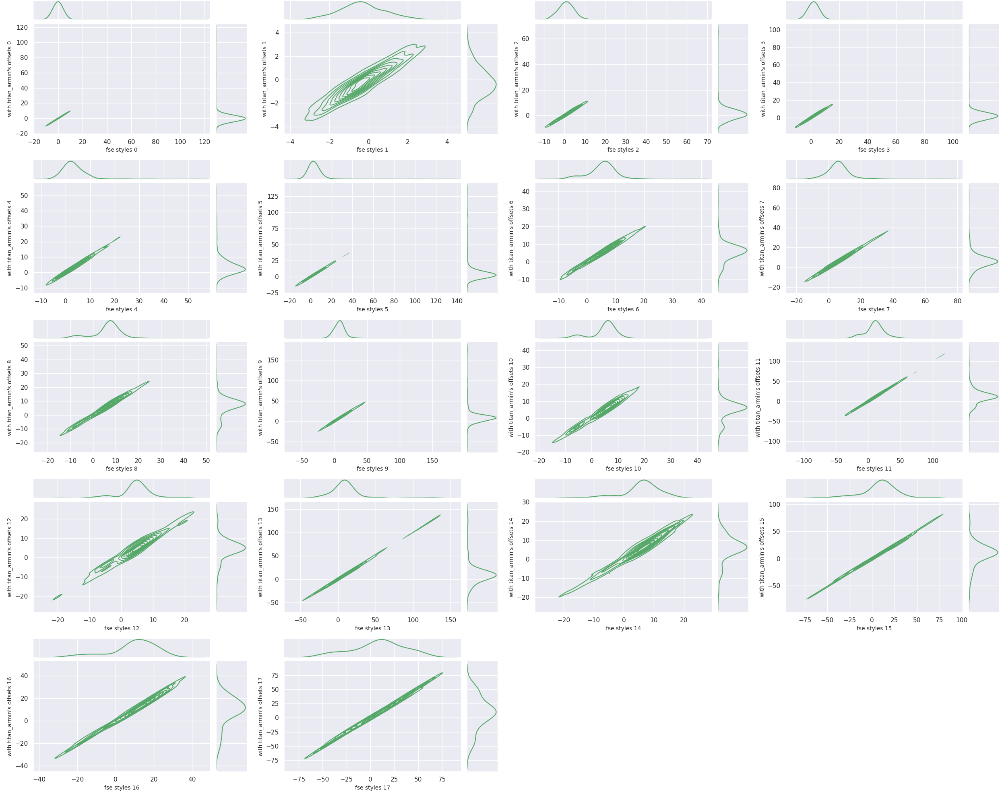

In [20]:
plot_latent_correlations_by_layer(
    fse_im_styles_numpy,
    [[style + offset for style, offset in zip(fse_im_styles_numpy[0], layer_offsets_numpy[0])]],
    x_name="fse styles",
    y_name=f"with {s_domain}'s offsets"
)

In [26]:
stoch_im_styles_offsets_numpy = [[style + offset for style, offset in zip(stoch_im_styles_numpy[0], layer_offsets_numpy[0])]]
e4e_im_styles_offsets_numpy = [[style + offset for style, offset in zip(e4e_im_styles_numpy[0], layer_offsets_numpy[0])]]
fse_im_styles_offsets_numpy = [[style + offset for style, offset in zip(fse_im_styles_numpy[0], layer_offsets_numpy[0])]]

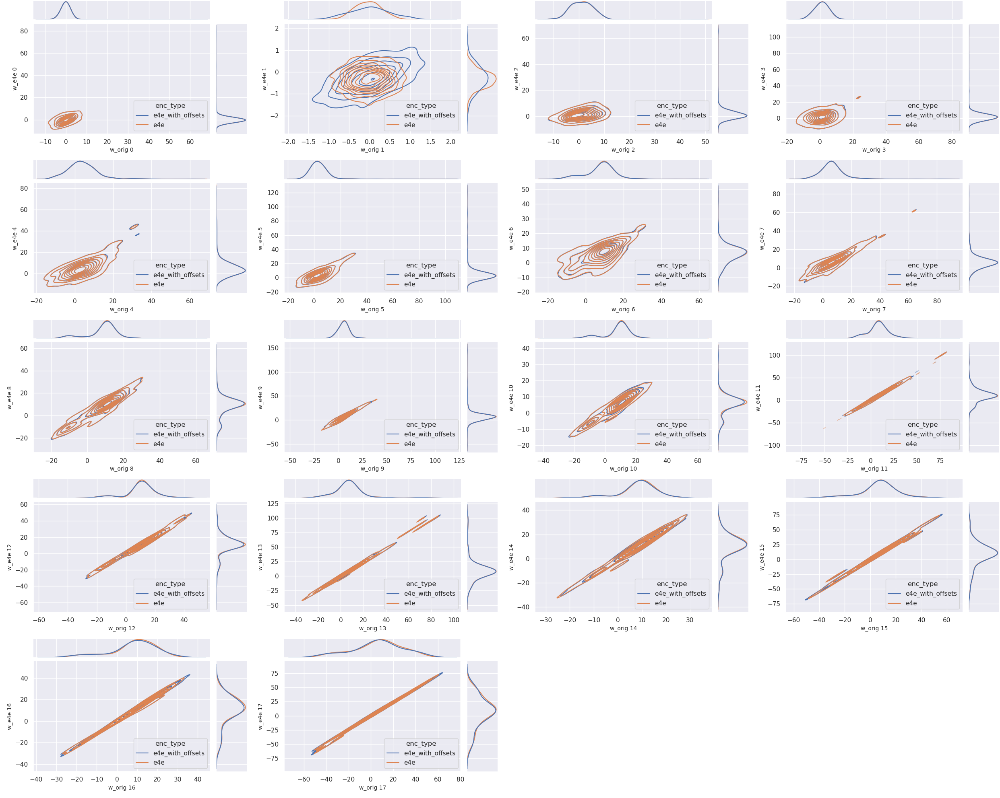

In [27]:
plot_latent_correlations_by_layer(
    e4e_im_styles_offsets_numpy,
    e4e_im_styles_numpy,
    stoch_im_styles_offsets_numpy,
    stoch_im_styles_numpy,
    x_name='w_orig', y_name='w_e4e', hue_name='enc_type',
    first_encoder_name='e4e_with_offsets', second_encoder_name='e4e'
)

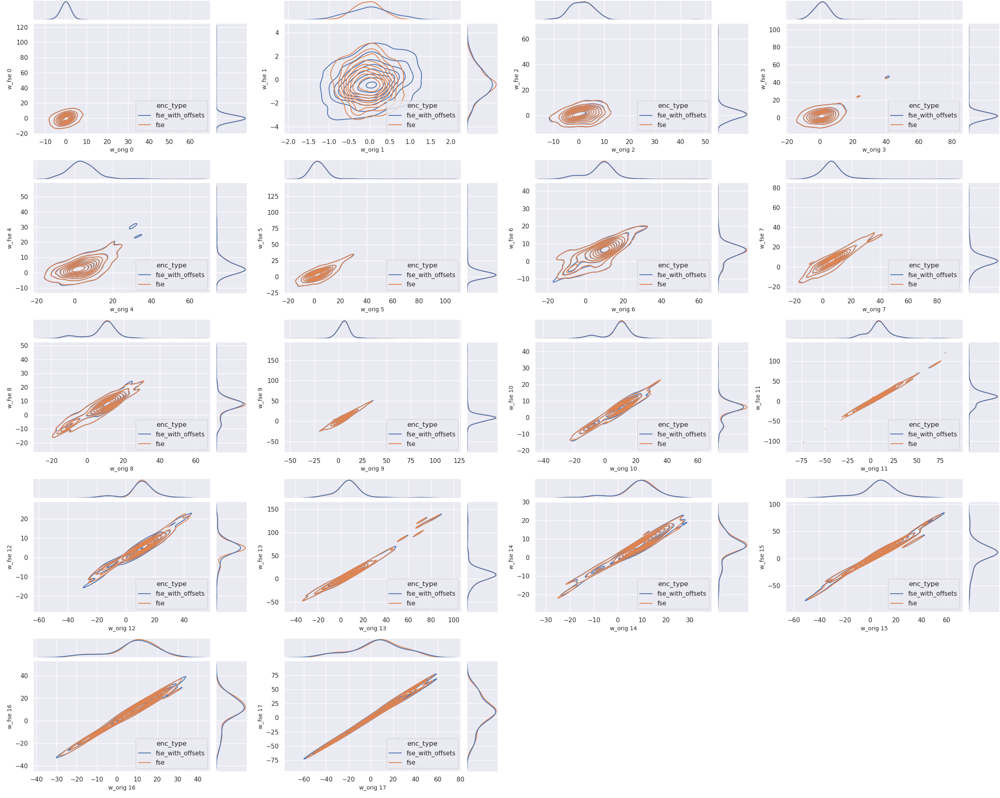

In [28]:
plot_latent_correlations_by_layer(
    fse_im_styles_offsets_numpy,
    fse_im_styles_numpy,
    stoch_im_styles_offsets_numpy,
    stoch_im_styles_numpy,
    x_name='w_orig', y_name='w_fse', hue_name='enc_type',
    first_encoder_name='fse_with_offsets', second_encoder_name='fse'
)

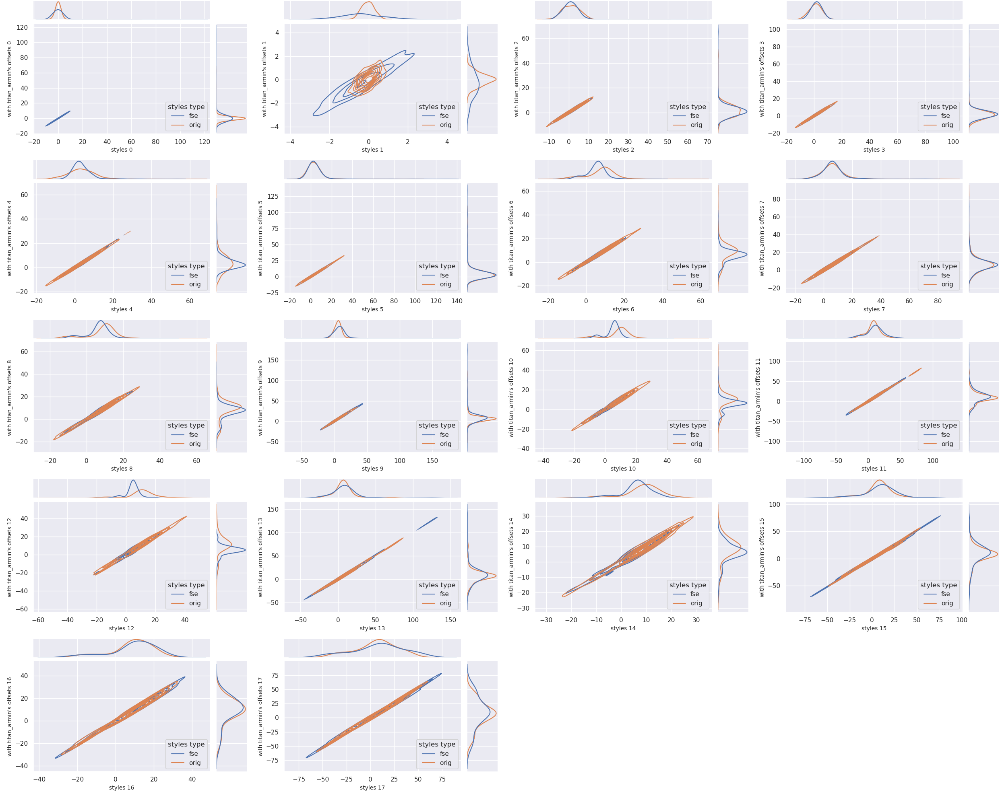

In [29]:
plot_latent_correlations_by_layer(
    fse_im_styles_offsets_numpy,
    stoch_im_styles_offsets_numpy,
    fse_im_styles_numpy,
    stoch_im_styles_numpy,
    x_name="styles",
    y_name=f"with {s_domain}'s offsets",
    hue_name="styles type",
    first_encoder_name="fse",
    second_encoder_name="orig"
)

In [30]:
stoch_similarities = []
for i, (s1, s2) in enumerate(zip(stoch_im_styles_numpy[0], stoch_im_styles_offsets_numpy[0])):
    stoch_similarities.append((s1 * s2).sum() / (np.linalg.norm(s1) * np.linalg.norm(s2)))

fse_similarities = []
for i, (s1, s2) in enumerate(zip(fse_im_styles_numpy[0], fse_im_styles_offsets_numpy[0])):
    fse_similarities.append((s1 * s2).sum() / (np.linalg.norm(s1) * np.linalg.norm(s2)))

e4e_similarities = []
for i, (s1, s2) in enumerate(zip(e4e_im_styles_numpy[0], e4e_im_styles_offsets_numpy[0])):
    e4e_similarities.append((s1 * s2).sum() / (np.linalg.norm(s1) * np.linalg.norm(s2)))

for i, (stoch_sim, fse_sim, e4e_sim) in enumerate(zip(stoch_similarities, fse_similarities, e4e_similarities)):
    print(f'{i}-th layer\tstoch_sim: {stoch_sim:.3f}\tfse_sim: {fse_sim:.3f}\t \
        e4e_sim: {e4e_sim:.3f} \tfse_diff: {(fse_sim - stoch_sim):.3f} \te4e_diff: {(e4e_sim - stoch_sim):.3f}')

0-th layer	stoch_sim: 1.000	fse_sim: 1.000	         e4e_sim: 1.000 	fse_diff: -0.000 	e4e_diff: -0.000
1-th layer	stoch_sim: 0.609	fse_sim: 0.944	         e4e_sim: 0.758 	fse_diff: 0.334 	e4e_diff: 0.148
2-th layer	stoch_sim: 0.996	fse_sim: 0.996	         e4e_sim: 0.995 	fse_diff: 0.000 	e4e_diff: -0.000
3-th layer	stoch_sim: 0.998	fse_sim: 0.999	         e4e_sim: 0.999 	fse_diff: 0.000 	e4e_diff: 0.001
4-th layer	stoch_sim: 0.998	fse_sim: 0.997	         e4e_sim: 0.998 	fse_diff: -0.001 	e4e_diff: 0.000
5-th layer	stoch_sim: 0.999	fse_sim: 0.999	         e4e_sim: 0.999 	fse_diff: 0.000 	e4e_diff: 0.000
6-th layer	stoch_sim: 0.998	fse_sim: 0.996	         e4e_sim: 0.997 	fse_diff: -0.002 	e4e_diff: -0.001
7-th layer	stoch_sim: 0.998	fse_sim: 0.998	         e4e_sim: 0.998 	fse_diff: -0.000 	e4e_diff: -0.000
8-th layer	stoch_sim: 0.998	fse_sim: 0.996	         e4e_sim: 0.998 	fse_diff: -0.002 	e4e_diff: -0.000
9-th layer	stoch_sim: 0.997	fse_sim: 0.999	         e4e_sim: 0.998 	fse_diff: 0.0

In [17]:
ws_e4e = torch.cat(ws_e4e, dim=0)
ws_fse = torch.cat(ws_fse, dim=0)

In [18]:
latent_corr_sample_layer = (ws_e4e * ws_fse).sum(dim=2) / (torch.norm(ws_e4e, dim=2) * torch.norm(ws_fse, dim=2))

mean_latent_corr_layer = torch.mean(latent_corr_sample_layer, dim=0)
mean_latent_corr_sample = torch.mean(latent_corr_sample_layer, dim=1)

# max_latent_corr_layer - max correlation over all samples for each layer
# max_latent_corr_sample - max correlation over all layers for each sample - layer indices are useful

max_latent_corr_layer, max_latent_corr_layer_indices = torch.max(latent_corr_sample_layer, dim=0)
max_latent_corr_sample, max_latent_corr_sample_indices = torch.max(latent_corr_sample_layer, dim=1)

sorted_mean_corr_indices = torch.argsort(mean_latent_corr_sample)
low_mean_corr_indices = sorted_mean_corr_indices[:10]
high_mean_corr_indices = sorted_mean_corr_indices[-10:]

sorted_max_corr_indices = torch.argsort(max_latent_corr_sample)
low_max_corr_indices = sorted_max_corr_indices[:10]
high_max_corr_indices = sorted_max_corr_indices[-10:]

print(f'Max correlations per each layer over all samples of ffhq-small:\n{max_latent_corr_layer.cpu().numpy()}')
print(f'Mean correlations per each layer over all samples of ffhq-small:\n{mean_latent_corr_layer.cpu().numpy()}')

Max correlations per each layer over all samples of ffhq-small:
[0.4578444  0.37468487 0.37769738 0.34170803 0.41877365 0.29365674
 0.3412362  0.29458168 0.4586471  0.35361248 0.38989225 0.26413324
 0.4632032  0.3042529  0.41205466 0.3735203  0.4912614  0.5448245 ]
Mean correlations per each layer over all samples of ffhq-small:
[0.2852512  0.22734001 0.24124329 0.22100696 0.28708875 0.1754174
 0.23221657 0.17551625 0.35009795 0.21542364 0.26024762 0.13160661
 0.2979705  0.13935763 0.29859576 0.2606571  0.34220663 0.37785968]


In [19]:
mean_latent_corr_sample[low_mean_corr_indices], low_mean_corr_indices, \
    mean_latent_corr_sample[high_mean_corr_indices], high_mean_corr_indices

(tensor([0.1924, 0.1956, 0.2012, 0.2047, 0.2053, 0.2071, 0.2074, 0.2081, 0.2086,
         0.2088], device='cuda:0'),
 tensor([ 994, 1985,  839,  809, 1172, 2386, 2219, 1041,  838, 1152],
        device='cuda:0'),
 tensor([0.2935, 0.2940, 0.2961, 0.2966, 0.2969, 0.2972, 0.2983, 0.3008, 0.3017,
         0.3106], device='cuda:0'),
 tensor([2992, 1031,  572, 2947,  507, 1639, 2634, 2375, 2514, 2626],
        device='cuda:0'))

In [20]:
max_latent_corr_sample[low_max_corr_indices], low_max_corr_indices, \
    max_latent_corr_sample[high_max_corr_indices], high_max_corr_indices

(tensor([0.3009, 0.3074, 0.3096, 0.3103, 0.3142, 0.3151, 0.3166, 0.3168, 0.3175,
         0.3196], device='cuda:0'),
 tensor([1608,  837,  316,  704, 1985, 1589, 3091, 2597, 2160,  295],
        device='cuda:0'),
 tensor([0.5158, 0.5160, 0.5169, 0.5175, 0.5208, 0.5216, 0.5223, 0.5313, 0.5415,
         0.5448], device='cuda:0'),
 tensor([2992,  149,  491, 1700,  139, 1233, 1128,  134, 1810, 1680],
        device='cuda:0'))

In [47]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import pandas as pd
import seaborn as sns; sns.set()
import warnings

from matplotlib.text import Text
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

def plot_latent_distributions_by_layer(
    ws_by_layer_numpy, ws_names, method="TSNE"
):
    """
        ws_by_layer_numpy: a list of ws as numpy arrays per each encoder
        ws_names: a list of names per each encoder
    """
    warnings.filterwarnings(
        action='ignore',
        category=FutureWarning
    )

    # fig = plt.figure(figsize=(25, 20))
    
    data_ = {
        "x": [], "y": [], "hue": [], "latent_idx": []
    }

    for latent_idx in range(18):
        projections = []
        for w in ws_by_layer_numpy:
            if method == "TSNE":
                tsne = TSNE(n_components=2, perplexity=30)
                projections.append(tsne.fit_transform(w[latent_idx]))
            elif method == "PCA":
                pca = PCA(n_components=2)
                projections.append(pca.fit_transform(w[latent_idx]))
            else:
                assert False, "method must be either TSNE or PCA"

        data_["x"].append(np.concatenate([p[:, 0] for p in projections], axis=0))
        data_["y"].append(np.concatenate([p[:, 1] for p in projections], axis=0))
        data_["hue"] += [name for p, name in zip(projections, ws_names) for _ in range(len(p))]
        data_["latent_idx"] += [latent_idx] * len(data_["x"][-1])

    data_["x"] = np.concatenate(data_["x"], axis=0)
    data_["y"] = np.concatenate(data_["y"], axis=0)

    df = pd.DataFrame.from_dict(data_)
    g = sns.FacetGrid(df, col="latent_idx",  col_wrap=4)
    g.map(sns.scatterplot, "x", "y")

        # g[-1].set_axis_labels(f'{x_name} {latent_idx}', f'{y_name} {latent_idx}', fontsize=10)

#                 # x_min, x_max = latent3.min(), latent3.max()
#                 quantile = 0.5
#                 x_min, x_max = np.percentile(latent3, quantile), np.percentile(latent3, 100 - quantile)
#                 g[-1].ax_joint.plot([x_min, x_max], [x_min, x_max], 'green', linewidth=1.5)

#                 quantile = 0.5
#                 x_min = min(np.percentile(latent1, quantile), np.percentile(latent2, quantile))
#                 x_max = max(np.percentile(latent1, 100 - quantile), np.percentile(latent2, 100 - quantile))
#                 g[-1].ax_marg_x.set_xlim(x_min, x_max)
#                 g[-1].ax_marg_y.set_ylim(x_min, x_max)

        # sns.move_legend(g[-1].ax_joint, 'lower right')
        # mg.append(SeabornFig2Grid(g[-1], fig, gs[latent_idx], title=f'layer_{latent_idx}'))                

    # gs.tight_layout(fig)

In [41]:
len(e4e_styles[0])

18

In [48]:
stoch_styles_by_layer = [
    [x[i] for x in stoch_styles]
    for i in range(18)
]
e4e_styles_by_layer = [
    [x[i] for x in e4e_styles]
    for i in range(18)
]
fse_styles_by_layer = [
    [x[i] for x in fse_styles]
    for i in range(18)
]

data = [
    torch.cat(x, dim=0).cpu().numpy()
    for x in stoch_styles_by_layer
]
data_e4e = [
    torch.cat(x, dim=0).cpu().numpy()
    for x in e4e_styles_by_layer
]
data_fse = [
    torch.cat(x, dim=0).cpu().numpy()
    for x in fse_styles_by_layer
]

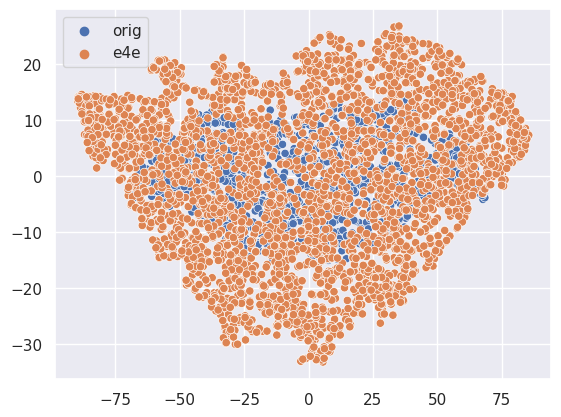

In [45]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

tsne = TSNE(n_components=2, perplexity=30)
projections = tsne.fit_transform(data[15])

tsne = TSNE(n_components=2, perplexity=30)
projections_e4e = tsne.fit_transform(data_e4e[15])

sns.scatterplot(
    x=np.concatenate([projections[:, 0], projections_e4e[:, 0]], axis=0),
    y=np.concatenate([projections[:, 1], projections_e4e[:, 1]], axis=0),
    hue=['orig'] * len(projections) + ['e4e'] * len(projections_e4e)
)
plt.show()

In [50]:
tsne = TSNE(n_components=2, perplexity=30)
projections = tsne.fit_transform(data[15])

array([[ 20.684422 ,  -4.638864 ],
       [-17.78837  ,   7.462933 ],
       [  2.4915938,  -3.492618 ],
       ...,
       [-21.013655 ,   2.5637677],
       [ 67.45399  ,  -3.4376137],
       [-22.90646  ,   4.8646293]], dtype=float32)

ValueError: operands could not be broadcast together with shapes (4,) (18,) 

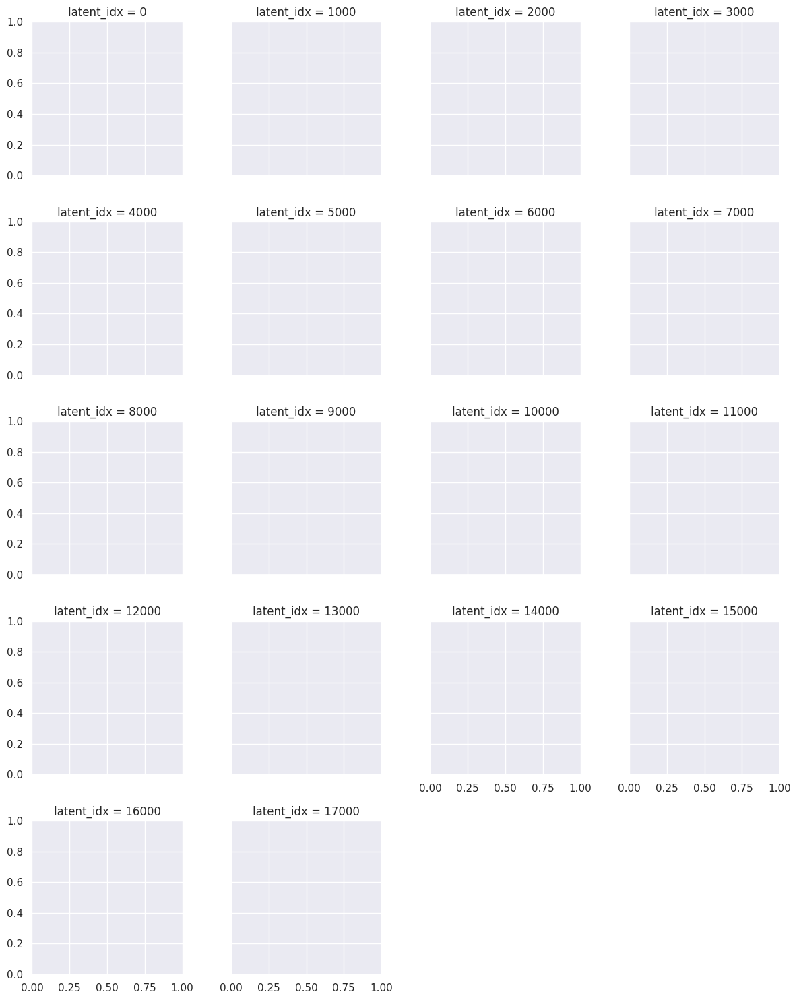

In [24]:
plot_latent_distributions_by_layer([data], ['orig'])

ValueError: operands could not be broadcast together with shapes (4,) (18000,) 

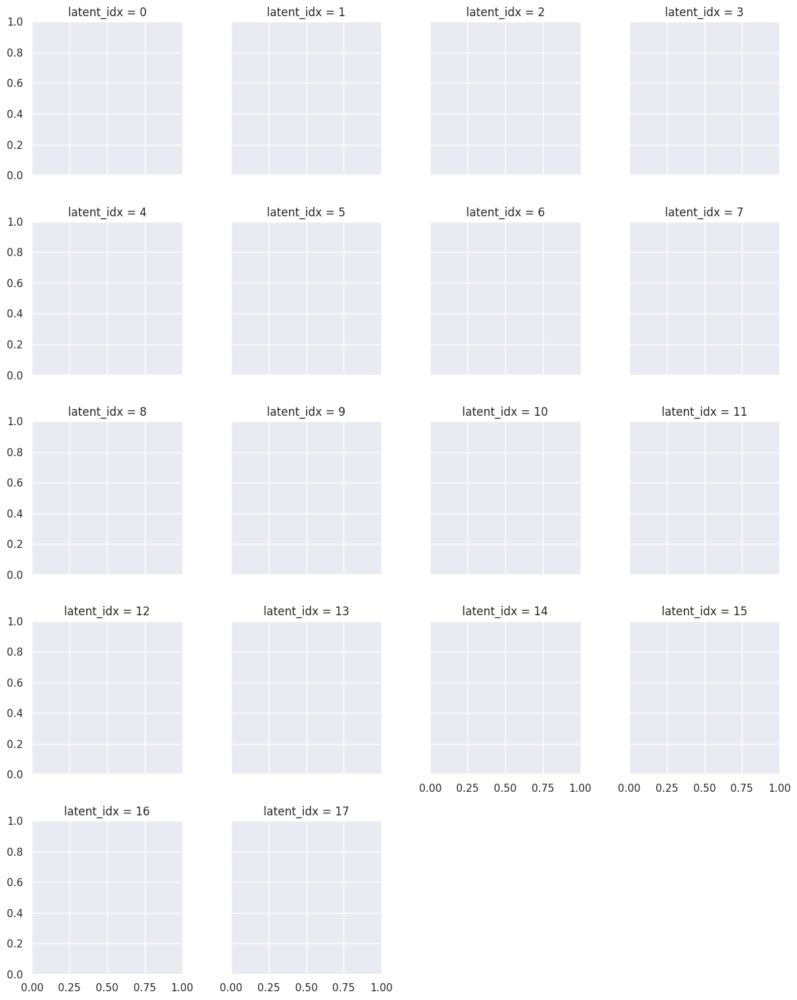

In [35]:
ws_by_layer_numpy = [data]
ws_names = ['orig']

data_ = {
    "x": [], "y": [], "hue": [], "latent_idx": []
}

for latent_idx in range(18):
    projections = []
    for w in ws_by_layer_numpy:
        tsne = TSNE(n_components=2, perplexity=30)
        projections.append(tsne.fit_transform(w[latent_idx]))

    data_["x"].append(np.concatenate([p[:, 0] for p in projections], axis=0))
    data_["y"].append(np.concatenate([p[:, 1] for p in projections], axis=0))
    data_["hue"] += [name for p, name in zip(projections, ws_names) for _ in range(len(p))]
    data_["latent_idx"] += [latent_idx] * len(data_["x"][-1])

data_["x"] = np.concatenate(data_["x"], axis=0)
data_["y"] = np.concatenate(data_["y"], axis=0)

In [39]:
import pandas as pd
df = pd.DataFrame.from_dict(data_)

In [40]:
df.head()

,x,y,hue,latent_idx
0,15.737989,-6.531704,orig,0
1,-13.475123,-9.530396,orig,0
2,10.024281,23.199293,orig,0
3,-4.899096,26.910004,orig,0
4,27.900198,23.257004,orig,0


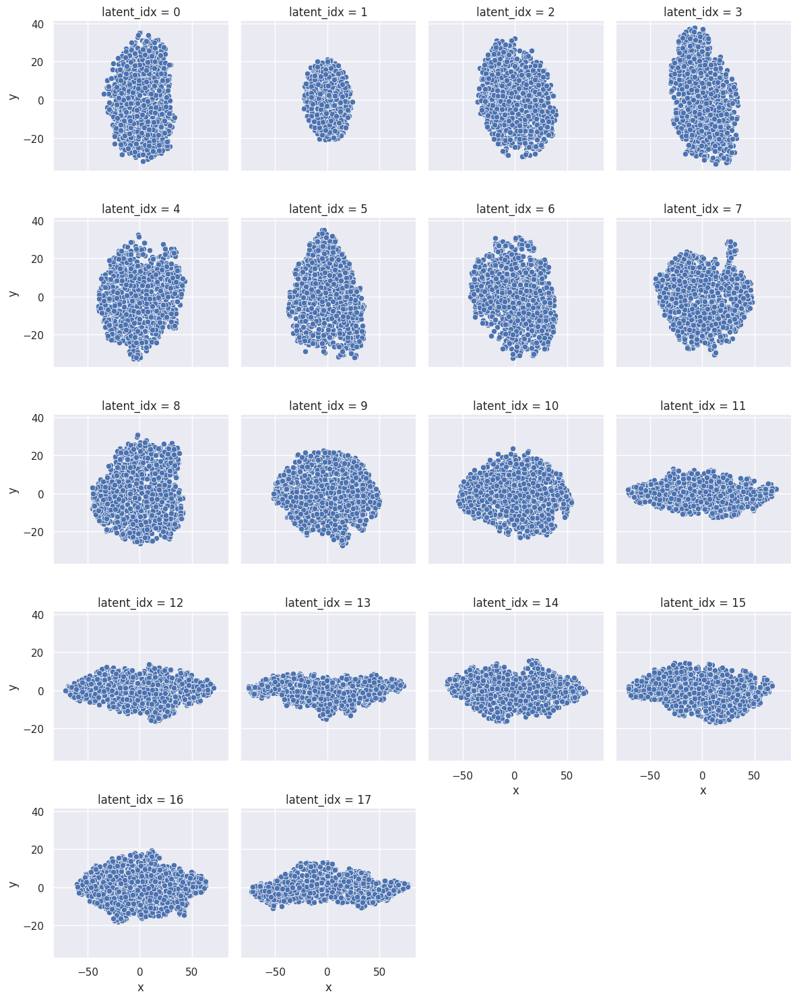

In [44]:
plot_latent_distributions_by_layer([data], ['orig'])

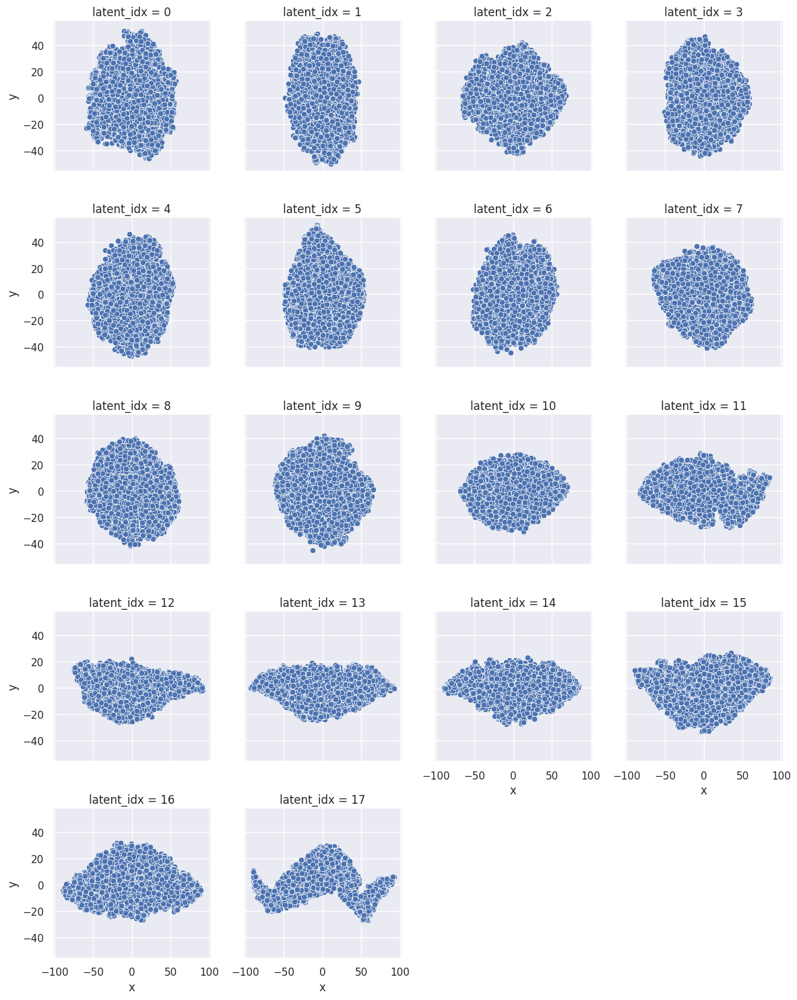

In [45]:
plot_latent_distributions_by_layer([data_e4e], ['e4e'])

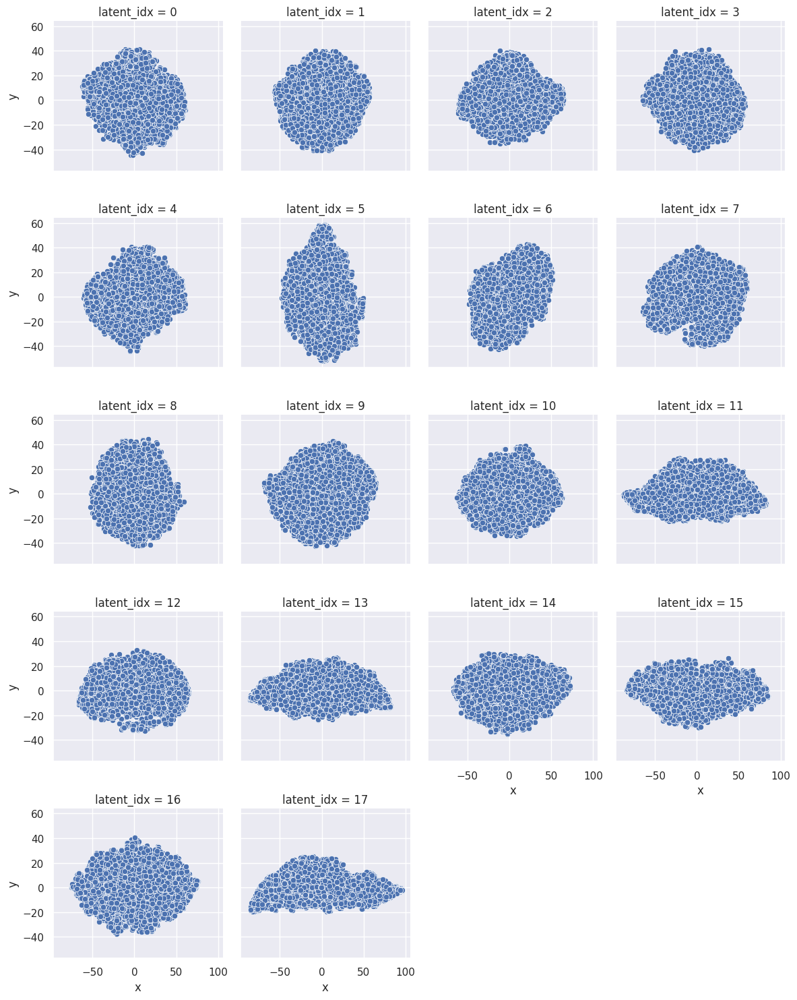

In [49]:
plot_latent_distributions_by_layer([data_fse], ['fse'])

In [ ]:
# PCA

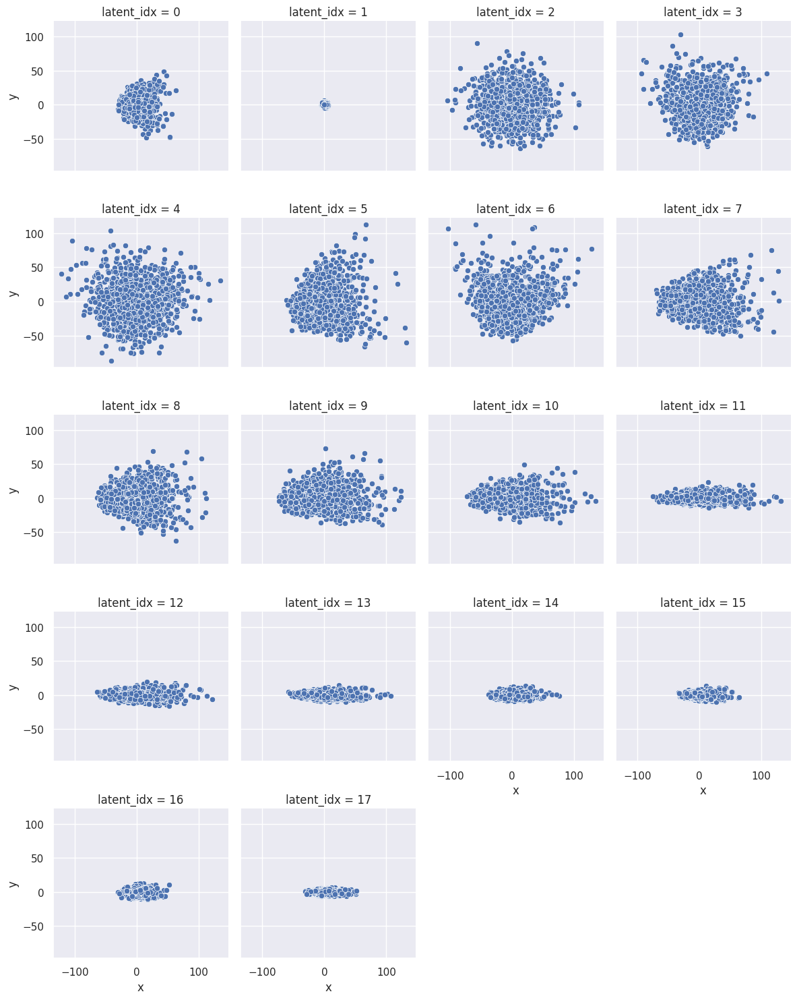

In [50]:
plot_latent_distributions_by_layer([data], ['orig'], method="PCA")

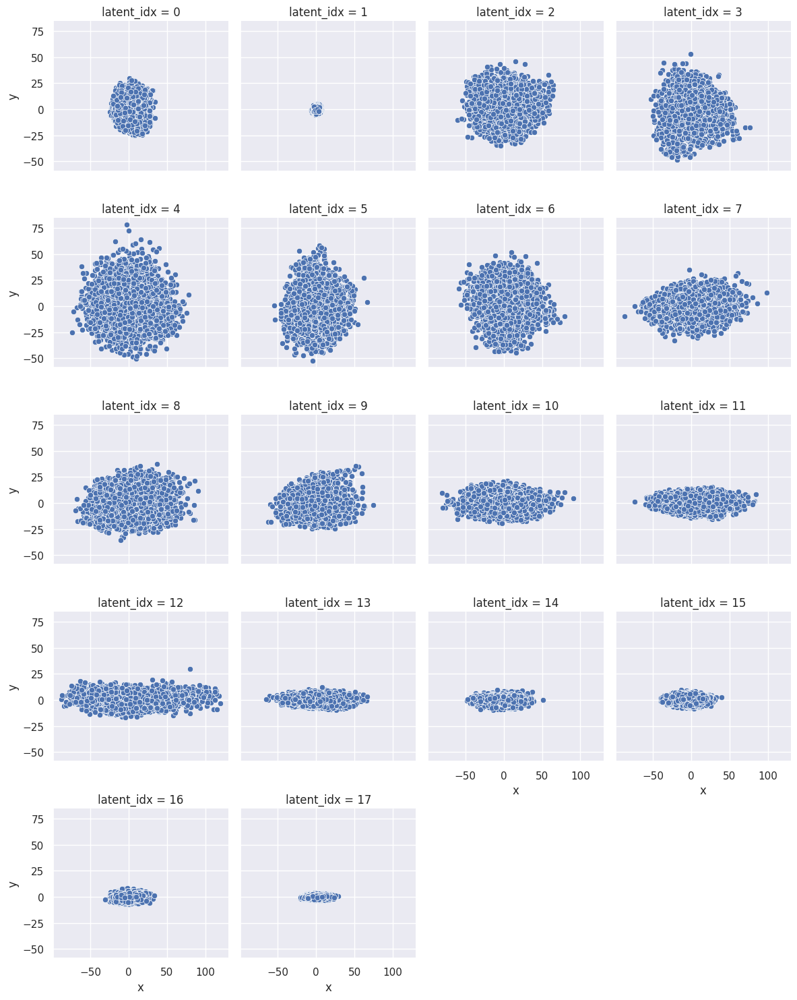

In [51]:
plot_latent_distributions_by_layer([data_e4e], ['e4e'], method="PCA")

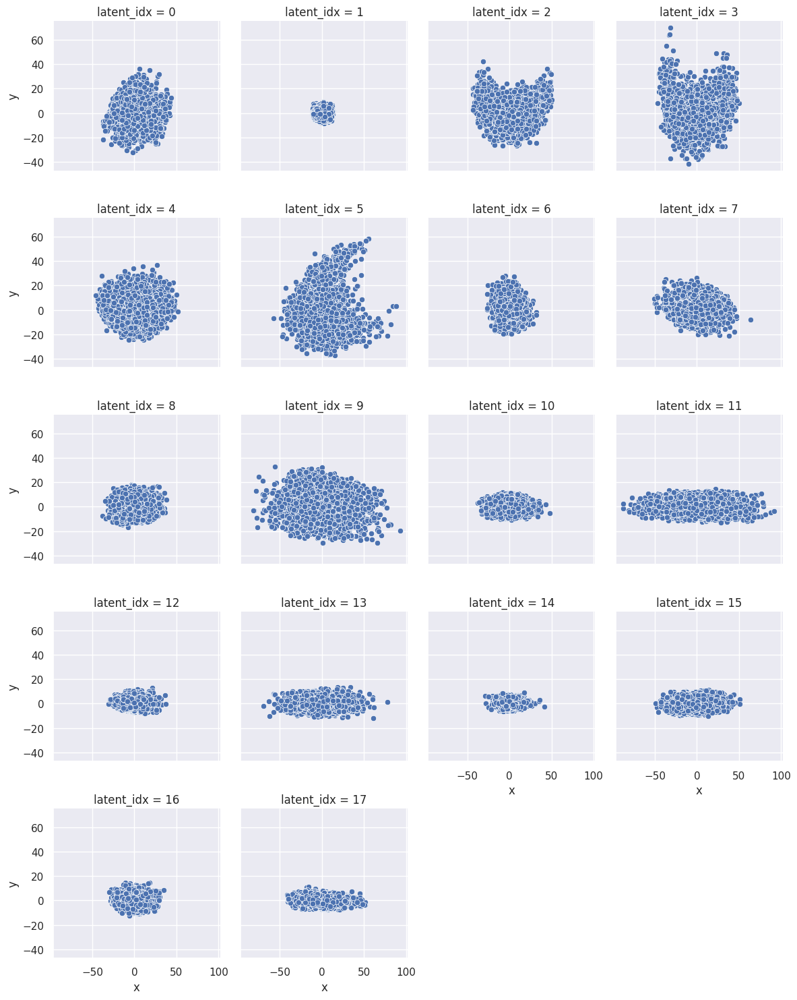

In [52]:
plot_latent_distributions_by_layer([data_fse], ['fse'], method="PCA")